# Train YOLO object detector with Turi Create

In [1]:
import os, sys, math
import pandas as pd
import turicreate as tc

Helper code for loading the CSV file and combining it with an SFrame. We only keep the images that we have annotations for.

In [2]:
def load_images_with_annotations(images_dir, annotations_file):
    # Load the images into a Turi SFrame.
    data = tc.image_analysis.load_images(images_dir, with_path=True)
    # Load the annotations CSV file into a Pandas dataframe.
    csv = pd.read_csv(annotations_file)

    # Loop through all the images and match these to the annotations from the
    # CSV file, if annotations are available for the image.
    all_annotations = []
    for i, item in enumerate(data):
        # Grab image info from the SFrame.
        img_path = item["path"]
        img_width = item["image"].width
        img_height = item["image"].height

        # Find the corresponding row(s) in the CSV's dataframe.
        image_id = os.path.basename(img_path)[:-4]
        rows = csv[csv["image_id"] == image_id]

        # Turi expects a list for every image that contains a dictionary for
        # every bounding box that we have an annotation for.
        img_annotations = []
        # The CSV file stores the coordinate as numbers between 0 and 1,
        # but Turi wants pixel coordinates in the image.
        
        # A bounding box in Turi is given by a center coordinate and the
        # width and height, we have them as the four corners of the box.

            
            # img_annotations.append({"coordinates": {"height": height, 
            #                                         "width": width, 
            #                                         "x": x, 
            #                                         "y": y}, 
            #                         "label": class_name})
        for row in rows.values:
            x_min=row[1]*img_width
            x_max=row[2]*img_width
            y_min=row[3]*img_height
            y_max=row[4]*img_height
            class_name=row[5]
            x=int((x_min+x_max)/2)
            y=int((y_min+y_max)/2)
            height=int(y_max-y_min)
            width=int(x_max-x_min)
            img_annotations.append({"coordinates":{"height":height,
                                                   "width":width,
                                                   "x":x,
                                                   "y":y},
                                    "label":class_name})
        # If there were no annotations for this image, then append a None
        # so that we can filter out those images from the SFrame.
        if len(img_annotations) > 0:
            all_annotations.append(img_annotations)
        else:
            all_annotations.append(None)

    data["annotations"] = tc.SArray(data=all_annotations, dtype=list)
    return data.dropna()

In [3]:
data_dir = "snacks"
train_dir = os.path.join(data_dir, "train")
val_dir = os.path.join(data_dir, "val")
test_dir = os.path.join(data_dir, "test")

In [4]:
data_dir

'snacks'

In [5]:
train_data = load_images_with_annotations(train_dir, data_dir + "/annotations-train.csv")

In [6]:
len(train_data)

4265

In [7]:
train_data.head()

path,image,annotations
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 341 Width: 256,"[{'coordinates':{'height': 94, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 341,"[{'coordinates':{'height': 121, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 384,"[{'coordinates':{'height': 87, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 341,"[{'coordinates':{'height': 149, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 341,"[{'coordinates':{'height': 100, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 382,"[{'coordinates':{'height': 37, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 256,"[{'coordinates':{'height': 52, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 256,"[{'coordinates':{'height': 176, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 446,"[{'coordinates':{'height': 58, 'width': ..."
/Users/nju/Desktop/task5/Code/iw05-CAR-hash/sn ...,Height: 256 Width: 341,"[{'coordinates':{'height': 61, 'width': ..."


In [8]:
train_data[0]

{'path': '/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/007a0bec00a90a66.jpg',
 'image': Height: 341px
 Width: 256px
 Channels: 3,
 'annotations': [{'coordinates': {'height': 94,
    'width': 111,
    'x': 73,
    'y': 113},
   'label': 'apple'},
  {'coordinates': {'height': 91, 'width': 116, 'x': 75, 'y': 118},
   'label': 'apple'},
  {'coordinates': {'height': 103, 'width': 113, 'x': 75, 'y': 111},
   'label': 'apple'}]}

Visualize the bounding boxes on top of the training data:

/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/visualization/_plot.py:461: UserWarning: Displaying only the first 100 rows.
  warnings.warn("Displaying only the first {} rows.".format(maximum_rows))


,path,image,annotations,image_with_ground_truth
0,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/007a0bec00a90a66.jpg,,"[{'coordinates': {'height': 94, 'width': 111, 'x': 73, 'y': 113}, 'label': 'apple'}, {'coordinates': {'height': 91, 'width': 116, 'x': 75, 'y': 118}, 'label': 'apple'}, {'coordinates': {'height': 103, 'width': 113, 'x': 75, 'y': 111}, 'label': 'apple'}]",
1,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/007ec56b6529e036.jpg,,"[{'coordinates': {'height': 121, 'width': 138, 'x': 184, 'y': 148}, 'label': 'apple'}, {'coordinates': {'height': 138, 'width': 139, 'x': 182, 'y': 138}, 'label': 'apple'}]",
2,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/00881627629888f6.jpg,,"[{'coordinates': {'height': 87, 'width': 83, 'x': 184, 'y': 209}, 'label': 'apple'}, {'coordinates': {'height': 90, 'width': 81, 'x': 182, 'y': 209}, 'label': 'apple'}]",
3,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/00bb5720a7ba062e.jpg,,"[{'coordinates': {'height': 149, 'width': 146, 'x': 169, 'y': 126}, 'label': 'apple'}, {'coordinates': {'height': 149, 'width': 141, 'x': 168, 'y': 124}, 'label': 'apple'}]",
4,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/00cc1c601b23f73d.jpg,,"[{'coordinates': {'height': 100, 'width': 90, 'x': 249, 'y': 170}, 'label': 'apple'}, {'coordinates': {'height': 105, 'width': 93, 'x': 246, 'y': 167}, 'label': 'apple'}]",
5,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/01477ea37494a8ac.jpg,,"[{'coordinates': {'height': 37, 'width': 35, 'x': 107, 'y': 89}, 'label': 'apple'}]",
6,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/018257a792aa90e6.jpg,,"[{'coordinates': {'height': 52, 'width': 52, 'x': 163, 'y': 58}, 'label': 'apple'}, {'coordinates': {'height': 48, 'width': 50, 'x': 163, 'y': 57}, 'label': 'apple'}]",
7,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/01968ea73417ec3b.jpg,,"[{'coordinates': {'height': 176, 'width': 179, 'x': 143, 'y': 166}, 'label': 'apple'}, {'coordinates': {'height': 178, 'width': 178, 'x': 143, 'y': 166}, 'label': 'apple'}]",
8,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/01ecc03a12e21e39.jpg,,"[{'coordinates': {'height': 58, 'width': 64, 'x': 232, 'y': 117}, 'label': 'apple'}, {'coordinates': {'height': 69, 'width': 90, 'x': 240, 'y': 116}, 'label': 'apple'}]",
9,/Users/nju/Desktop/task5/Code/iw05-CAR-hash/snacks/train/apple/021d2569ce62aa93.jpg,,"[{'coordinates': {'height': 61, 'width': 58, 'x': 29, 'y': 39}, 'label': 'apple'}, {'coordinates': {'height': 55, 'width': 70, 'x': 188, 'y': 228}, 'label': 'apple'}]",

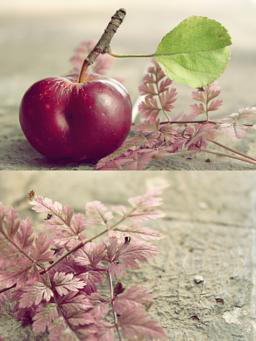
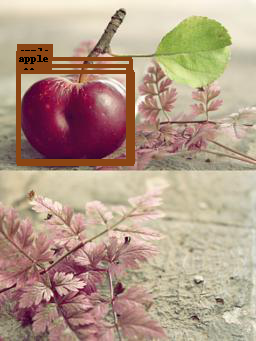
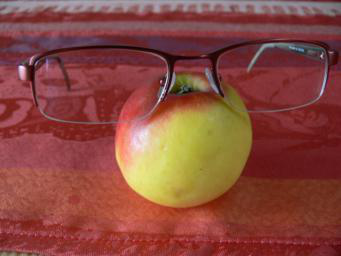
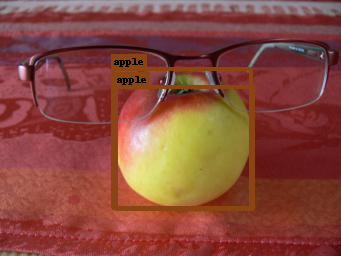
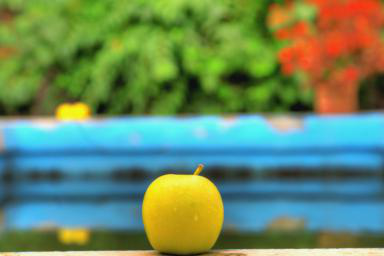
...
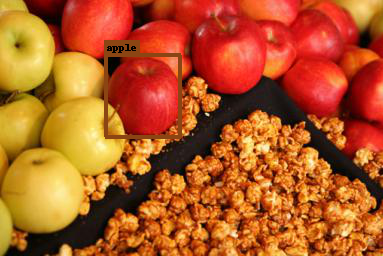
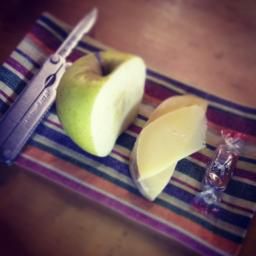
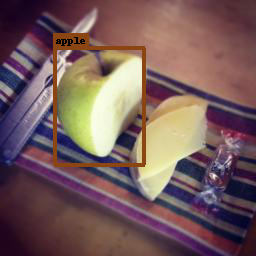
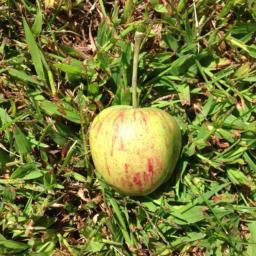
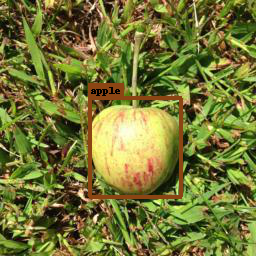

In [9]:
train_data['image_with_ground_truth'] = tc.object_detector.util.draw_bounding_boxes(
                                            train_data['image'], train_data['annotations'])
train_data.explore()

Train the model. This first downloads the Darknet feature extractor.

In [10]:
model = tc.object_detector.create(train_data, feature='image', annotations='annotations')

ERROR: Download failed: 
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/toolkits/_pre_trained_models.py", line 71, in _download_and_checksum_files
    for i, chunk in enumerate(r.iter_content(chunk_size=BUFFER)):
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/requests/models.py", line 758, in generate
    for chunk in self.raw.stream(chunk_size, decode_content=True):
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/urllib3/response.py", line 576, in stream
    data = self.read(amt=amt, decode_content=decode_content)
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/urllib3/response.py", line 519, in read
    data = self._fp.read(amt) if not fp_closed else b""
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/http/client.py", line 461, in read
    n = self.readinto(b)
  File "/Users/nju/opt/anaconda3/envs/turienv/lib/python3.7/http/client.py", line 505, i

TypeError: object of type 'NoneType' has no len()

Save the model. Also export to Core ML.

In [ ]:
model.save("SnackDetector.model")

In [ ]:
model.export_coreml("SnackDetector.mlmodel")

Load the model and evaluate it on the test set.

In [ ]:
model = tc.load_model("SnackDetector.model")

In [ ]:
val_data = load_images_with_annotations(val_dir, data_dir + "/annotations-val.csv")
test_data = load_images_with_annotations(test_dir, data_dir + "/annotations-test.csv")

In [ ]:
scores = model.evaluate(test_data)

`model.evaluate()` computes the "average precision" for each class, as well as the overall mean average precision metric. Higher is better.

In [ ]:
scores

Make predictions on the test data. This outputs something like this:

```
[{'confidence': 0.7225357099539148,
  'coordinates': {'height': 73.92794444010806,
                  'width': 90.45315889211807,
                  'x': 262.2198759929745,
                  'y': 155.496952970812},
  'label': 'dog',
  'type': 'rectangle'},
 ...]
```

which is similar to the annotations, but now there is a `confidence` field as well.

In [ ]:
test_data["predictions"] = model.predict(test_data)

In [ ]:
test_data.head()

Visualize the predicted bounding boxes on top of the test set:

In [ ]:
test_data['image_with_predictions'] = tc.object_detector.util.draw_bounding_boxes(
                                           test_data['image'], test_data['predictions'])

In [ ]:
test_data.head()

In [ ]:
test_data.explore()